In [1]:
import os
import sys
import numpy as np
from tqdm import tqdm
from PIL import Image
import matplotlib.pyplot as plt
from skimage import io, util, transform
import random
import glob

from torch.utils.data import Dataset, DataLoader
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.optim.lr_scheduler import ReduceLROnPlateau

from scipy.ndimage import gaussian_filter
import gc

from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
# --- Parameters ---
image_folder = '/content/drive/MyDrive/denoise/images'
output_path = '/content/drive/MyDrive/denoise/y_train.npy'
crop_size = 128
max_total_bytes = 3 * 1024**3  # 2 GB
check_every = 5000  # Check memory usage after this many crops

In [ ]:
# Load image paths
image_paths = glob.glob(f"{image_folder}/*")
random.shuffle(image_paths)

def get_random_crop(img, crop_size):
    h, w, _ = img.shape
    if h < crop_size or w < crop_size:
        return None
    top = random.randint(0, h - crop_size)
    left = random.randint(0, w - crop_size)
    return img[top:top + crop_size, left:left + crop_size, :]

# Calculate max crops and create memory-mapped array
single_crop_bytes = crop_size * crop_size * 3  # RGB
max_crops = max_total_bytes // single_crop_bytes

# Create memory-mapped array that writes directly to disk
crops_array = np.memmap(output_path.replace('.npy', '_temp.dat'),
                       dtype=np.uint8, mode='w+',
                       shape=(max_crops, crop_size, crop_size, 3))

# Progress bar tracking bytes used
pbar = tqdm(total=max_total_bytes, unit_scale=True, unit="B", desc="Cropping",
            disable=False, file=sys.stdout, ncols=80)

current_bytes = 0
crop_count = 0

while current_bytes < max_total_bytes and crop_count < max_crops:
    img_path = random.choice(image_paths)

    try:
        img = Image.open(img_path).convert('RGB')
        img.load()
        img = np.array(img, dtype=np.uint8)

        crop = get_random_crop(img, crop_size)
        if crop is not None:
            crop_bytes = crop.nbytes

            # Check if adding this crop would exceed limit
            if current_bytes + crop_bytes > max_total_bytes:
                break

            # Write directly to memory-mapped array (no RAM accumulation)
            crops_array[crop_count] = crop
            crop_count += 1
            current_bytes += crop_bytes
            pbar.update(crop_bytes)

    except Exception as e:
        print(f"⚠️ Error processing {img_path}: {e}")
        continue

pbar.close()

# Trim array to actual size and save as .npy
final_crops = crops_array[:crop_count]
np.save(output_path, final_crops)

# Clean up temp file
os.remove(output_path.replace('.npy', '_temp.dat'))

gc.collect()

print(f"\n✅ Done. Total patches: {crop_count}")
print(f"💾 Saved to: {output_path}")
print(f"🗂️ Final size: {current_bytes / (1024**2):.2f} MB")

Cropping: 100%|████████████████████████████▉| 2.15G/2.15G [41:35<00:00, 861kB/s]

✅ Done. Total patches: 43690
💾 Saved to: /content/drive/MyDrive/denoise/y_train.npy
🗂️ Final size: 2047.97 MB


In [ ]:
y_train = np.load(output_path)
print(y_train.shape)

In [3]:
# --- Corruption functions ---
def apply_gaussian_noise(image, severity):
    noise = np.random.normal(0, severity, image.shape).astype(np.float32)
    return image + noise

def apply_poisson_noise(image):
    # Simulate low-light condition to exaggerate Poisson noise
    intensity_scale = random.uniform(30, 100)  # lower = more noise
    image_scaled = np.clip(image * intensity_scale, 0, 255)

    noisy = np.random.poisson(image_scaled).astype(np.float32)
    noisy = noisy / intensity_scale  # scale back to 0–1

    return np.clip(noisy, 0, 1)

def apply_saltpepper_noise(image, severity):
    output = image.copy()
    num_salt = int(np.ceil(severity * image.size * 0.5))
    num_pepper = int(np.ceil(severity * image.size * 0.5))

    coords_salt = [np.random.randint(0, i, num_salt) for i in image.shape[:2]]
    coords_pepper = [np.random.randint(0, i, num_pepper) for i in image.shape[:2]]

    if image.ndim == 3:
        output[coords_salt[0], coords_salt[1], :] = 1.0
        output[coords_pepper[0], coords_pepper[1], :] = 0.0
    else:  # grayscale
        output[coords_salt[0], coords_salt[1]] = 1.0
        output[coords_pepper[0], coords_pepper[1]] = 0.0

    return output


def apply_pepper_noise(image, severity):
    output = image.copy()
    num_pepper = int(np.ceil(severity * image.size))

    coords_pepper = [np.random.randint(0, i, num_pepper) for i in image.shape[:2]]

    if image.ndim == 3:
        output[coords_pepper[0], coords_pepper[1], :] = 0.0
    else:
        output[coords_pepper[0], coords_pepper[1]] = 0.0

    return output


def apply_speckle_noise(image, severity):
    noise = np.random.randn(*image.shape).astype(np.float32)
    return image + image * noise * severity

In [ ]:
# --- Linear-biased sampling function ---
def sample_severity(a, b):
    """Sample from a linear PDF increasing from a to b (i.e., favoring higher severity)."""
    u = random.random()
    return np.sqrt((b**2 - a**2) * u + a**2)

# --- Category-Specific Corruption ---
def corrupt_smooth(img):
    kind = random.choice(['gaussian', 'poisson', 'speckle'])
    img = img.astype(np.float32) / 255.0

    if kind == 'gaussian':
        sev = sample_severity(0.05, 0.22)
        out = apply_gaussian_noise(img, sev)
    elif kind == 'poisson':
        out = apply_poisson_noise(img)
    elif kind == 'speckle':
        sev = sample_severity(0.05, 0.3)
        out = apply_speckle_noise(img, sev)

    return np.clip(out * 255.0, 0, 255).astype(np.uint8)

def corrupt_discreet(img):
    kind = random.choice(['saltpepper', 'pepper'])
    img = img.astype(np.float32) / 255.0

    if kind == 'saltpepper':
        sev = sample_severity(0.02, 0.05)
        out = apply_saltpepper_noise(img, sev)
    elif kind == 'pepper':
        sev = sample_severity(0.02, 0.05)
        out = apply_pepper_noise(img, sev)

    return np.clip(out * 255.0, 0, 255).astype(np.uint8)

# --- Main Generation Function ---
def generate_separate_smooth_and_discreet(x_clean_array, x_out_smooth, x_out_discreet):
    print(f"Generating smooth & discreet corrupted sets from {len(x_clean_array)} samples...")

    x_smooth = np.empty_like(x_clean_array, dtype=np.uint8)
    x_discreet = np.empty_like(x_clean_array, dtype=np.uint8)

    for idx, img in enumerate(tqdm(x_clean_array, desc="Corrupting")):
        x_smooth[idx] = corrupt_smooth(img)
        x_discreet[idx] = corrupt_discreet(img)

        if idx % 1000 == 0:
            gc.collect()

    print("Saving arrays...")
    np.save(x_out_smooth, x_smooth)
    np.save(x_out_discreet, x_discreet)

    print("✅ Done!")
    print("  Smooth :", x_smooth.shape, x_smooth.dtype)
    print("  Discreet:", x_discreet.shape, x_discreet.dtype)

# --- Usage ---
y_train = np.load('/content/drive/MyDrive/denoise/y_train.npy')
print("y_train shape:", y_train.shape)

X_SMOOTH_OUT = '/content/drive/MyDrive/denoise/x_train_smooth.npy'
X_DISCREET_OUT = '/content/drive/MyDrive/denoise/x_train_discreet.npy'

generate_separate_smooth_and_discreet(y_train, X_SMOOTH_OUT, X_DISCREET_OUT)


y_train shape: (65536, 128, 128, 3)
Generating smooth & discreet corrupted sets from 65536 samples...


Corrupting: 100%|██████████| 65536/65536 [04:49<00:00, 226.65it/s]


Saving arrays...
✅ Done!
  Smooth : (65536, 128, 128, 3) uint8
  Discreet: (65536, 128, 128, 3) uint8


In [ ]:
x_train_smooth = np.load('/content/drive/MyDrive/denoise/data/x_train_smooth.npy')
print("x_train_smooth shape:", x_train_smooth.shape)

In [ ]:
x_train_discreet = np.load('/content/drive/MyDrive/denoise/data/x_train_discreet.npy')
print("x_train_discreet shape:", x_train_discreet.shape)

x_train_discreet shape: (65536, 128, 128, 3)


In [ ]:
y_train = np.load('/content/drive/MyDrive/denoise/data/y_train.npy')
print("y_train shape:", y_train.shape)

y_train shape: (65536, 128, 128, 3)


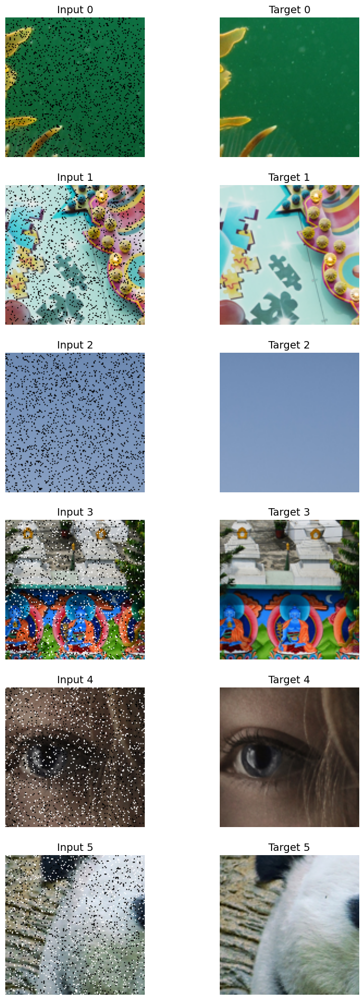

In [ ]:
# Sanity check
num_samples = 6
fig, axes = plt.subplots(num_samples, 2, figsize=(10, num_samples * 4))  # Each row: input/output

for i in range(num_samples):
    # Noisy Input
    axes[i, 0].imshow(x_train_discreet[i])
    axes[i, 0].set_title(f"Input {i}", fontsize=14)
    axes[i, 0].axis('off')

    # Clean Target
    axes[i, 1].imshow(y_train[i])
    axes[i, 1].set_title(f"Target {i}", fontsize=14)
    axes[i, 1].axis('off')

plt.subplots_adjust(wspace=0.1, hspace=0.2)
plt.show()

In [ ]:
# --- Visualize 5 samples for each noise type ---
def show_corruption_examples(samples):
    corruption_types = ['gaussian', 'poisson', 'saltpepper', 'pepper', 'speckle']
    fig, axs = plt.subplots(len(corruption_types), 5, figsize=(15, 10))

    for row, corruption_type in enumerate(corruption_types):
        for col in range(5):
            img = samples[col].astype(np.float32) / 255.0

            if corruption_type == 'gaussian':
                severity = random.uniform(0.05, 0.35)
                corrupted = apply_gaussian_noise(img, severity)
            elif corruption_type == 'poisson':
                corrupted = apply_poisson_noise(img)
            elif corruption_type == 'saltpepper':
                severity = random.uniform(0.02, 0.05)
                corrupted = apply_saltpepper_noise(img, severity)
            elif corruption_type == 'pepper':
                severity = random.uniform(0.02, 0.05)
                corrupted = apply_pepper_noise(img, severity)
            elif corruption_type == 'speckle':
                severity = random.uniform(0.05, 0.3)
                corrupted = apply_speckle_noise(img, severity)

            corrupted = np.clip(corrupted * 255.0, 0, 255).astype(np.uint8)

            axs[row, col].imshow(corrupted)
            axs[row, col].axis('off')
            if col == 0:
                axs[row, col].set_title(corruption_type, fontsize=12)

    plt.tight_layout()
    plt.show()

# --- Load clean samples and visualize ---
show_corruption_examples(y_train[:5])


In [4]:
class UNet(nn.Module):
    def __init__(self, dropout_prob=0.4):
        super().__init__()
        self.dropout_prob = dropout_prob

        # Encoder
        self.enc1 = self.conv_block(3, 32)
        self.enc2 = self.conv_block(32, 64)
        self.enc3 = self.conv_block(64, 128)
        self.enc4 = self.conv_block(128, 256)

        # Bottleneck
        self.bottleneck = self.conv_block(256, 512)

        # Decoder (note increased in_c due to concatenation)
        self.up4 = self.up_block(512, 256)        # after upsample: 256, concat with e4 (256) → 512
        self.dec4 = self.conv_block(512, 256)

        self.up3 = self.up_block(256, 128)        # up:128, concat with e3 (128) → 256
        self.dec3 = self.conv_block(256, 128)

        self.up2 = self.up_block(128, 64)         # up:64, concat with e2 (64) → 128
        self.dec2 = self.conv_block(128, 64)

        self.up1 = self.up_block(64, 32)          # up:32, concat with e1 (32) → 64
        self.dec1 = self.conv_block(64, 32)

        # Output
        self.final = nn.Conv2d(32, 3, kernel_size=1)

    def conv_block(self, in_c, out_c):
        return nn.Sequential(
            nn.Conv2d(in_c, out_c, kernel_size=3, padding=1),
            nn.BatchNorm2d(out_c),
            nn.ReLU(inplace=True),
            nn.Conv2d(out_c, out_c, kernel_size=3, padding=1),
            nn.BatchNorm2d(out_c),
            nn.ReLU(inplace=True),
            nn.Dropout(self.dropout_prob)
        )

    def up_block(self, in_c, out_c):
        return nn.Sequential(
            nn.ConvTranspose2d(in_c, out_c, kernel_size=2, stride=2),
            nn.ReLU(inplace=True)
        )

    def forward(self, x):
        e1 = self.enc1(x)                      # 3 → 32
        e2 = self.enc2(F.max_pool2d(e1, 2))    # 32 → 64
        e3 = self.enc3(F.max_pool2d(e2, 2))    # 64 → 128
        e4 = self.enc4(F.max_pool2d(e3, 2))    # 128 → 256

        b = self.bottleneck(F.max_pool2d(e4, 2))  # 256 → 512

        d4 = self.up4(b)
        d4 = self.dec4(torch.cat((d4, e4), dim=1))  # 256 + 256 = 512

        d3 = self.up3(d4)
        d3 = self.dec3(torch.cat((d3, e3), dim=1))  # 128 + 128 = 256

        d2 = self.up2(d3)
        d2 = self.dec2(torch.cat((d2, e2), dim=1))  # 64 + 64 = 128

        d1 = self.up1(d2)
        d1 = self.dec1(torch.cat((d1, e1), dim=1))  # 32 + 32 = 64

        return torch.sigmoid(self.final(d1))

class ResidualBlock(nn.Module):
    def __init__(self, channels, kernel_size=3):
        super().__init__()
        padding = kernel_size // 2
        self.block = nn.Sequential(
            nn.Conv2d(channels, channels, kernel_size, padding=padding),
            nn.ReLU(inplace=True),
            nn.Conv2d(channels, channels, kernel_size, padding=padding),
        )

    def forward(self, x):
        return x + self.block(x)

class ResNet(nn.Module):
    def __init__(self, image_channels=3, depth=8, n_channels=64):
        super().__init__()
        self.entry = nn.Conv2d(image_channels, n_channels, 3, padding=1)
        self.blocks = nn.Sequential(*[ResidualBlock(n_channels) for _ in range(depth)])
        self.exit = nn.Conv2d(n_channels, image_channels, 3, padding=1)

    def forward(self, x):
        out = self.entry(x)
        out = self.blocks(out)
        out = self.exit(out)
        return x - out

In [ ]:
class DenoiseDataset(Dataset):
    def __init__(self, x_array, y_array):
        self.x = x_array
        self.y = y_array

    def __len__(self):
        return len(self.x)

    def __getitem__(self, idx):
        # Normalize and convert to torch tensors
        x = torch.from_numpy(self.x[idx].astype('float32') / 255.0).permute(2, 0, 1)
        y = torch.from_numpy(self.y[idx].astype('float32') / 255.0).permute(2, 0, 1)
        return x, y

In [ ]:
# Dataset & Dataloader
dataset = DenoiseDataset(x_train_smooth, y_train)
loader_smooth = DataLoader(dataset, batch_size=64, shuffle=True, num_workers=2)

In [ ]:
# Dataset & Dataloader
dataset = DenoiseDataset(x_train_discreet, y_train)
loader_discreet = DataLoader(dataset, batch_size=64, shuffle=True, num_workers=2)

In [ ]:
def train(model, dataloader, optimizer, criterion, scheduler, device, epochs=10):
    model.train()
    for epoch in range(epochs):
        epoch_loss = 0
        progress = tqdm(dataloader, desc=f"Epoch {epoch+1}/{epochs}")

        for noisy_input, noisy_target in progress:
            noisy_input = noisy_input.to(device)
            noisy_target = noisy_target.to(device)

            optimizer.zero_grad()
            output = model(noisy_input)
            loss = criterion(output, noisy_target)
            loss.backward()
            optimizer.step()

            epoch_loss += loss.item()
            progress.set_postfix(loss=loss.item())

        avg_loss = epoch_loss / len(dataloader)
        scheduler.step(avg_loss)  # update scheduler

        print(f"✅ Epoch {epoch+1} avg loss: {avg_loss:.4f} | LR: {optimizer.param_groups[0]['lr']:.2e}")

In [ ]:
# --- Setup ---
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = ResNet().to(device)
optimizer = torch.optim.Adam(model.parameters(), lr=1e-3, weight_decay=1e-5)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimizer, T_max=15, eta_min=1e-6)
criterion = nn.L1Loss()

# --- Paths ---
checkpoint_path = "/content/drive/MyDrive/denoise/checkpoints/res_discreet.pth"

# --- Load checkpoint if it exists ---
if os.path.exists(checkpoint_path):
    print(f"🔁 Loading checkpoint from {checkpoint_path}")
    model.load_state_dict(torch.load(checkpoint_path, map_location=device))
else:
    print("🆕 No checkpoint found, starting from scratch.")

# --- Train ---
train(model, loader_discreet, optimizer, criterion, scheduler, device, epochs=3)

# --- Save updated checkpoint ---
torch.save(model.state_dict(), checkpoint_path)
print(f"✅ Model saved to {checkpoint_path}")

🆕 No checkpoint found, starting from scratch.


Epoch 1/3: 100%|██████████| 1024/1024 [15:54<00:00,  1.07it/s, loss=0.00494]
/usr/local/lib/python3.11/dist-packages/torch/optim/lr_scheduler.py:243: UserWarning: The epoch parameter in `scheduler.step()` was not necessary and is being deprecated where possible. Please use `scheduler.step()` to step the scheduler. During the deprecation, if epoch is different from None, the closed form is used instead of the new chainable form, where available. Please open an issue if you are unable to replicate your use case: https://github.com/pytorch/pytorch/issues/new/choose.
  warnings.warn(EPOCH_DEPRECATION_WARNING, UserWarning)


✅ Epoch 1 avg loss: 0.0120 | LR: 1.00e-03


Epoch 2/3: 100%|██████████| 1024/1024 [15:54<00:00,  1.07it/s, loss=0.00373]


✅ Epoch 2 avg loss: 0.0042 | LR: 1.00e-03


Epoch 3/3: 100%|██████████| 1024/1024 [15:54<00:00,  1.07it/s, loss=0.00321]

✅ Epoch 3 avg loss: 0.0037 | LR: 1.00e-03
✅ Model saved to /content/drive/MyDrive/denoise/res_discreet.pth


In [ ]:
# --- Save updated checkpoint ---
torch.save(model.state_dict(), checkpoint_path)
print(f"✅ Model saved to {checkpoint_path}")


✅ Model saved to /content/drive/MyDrive/denoise/unet_model.pth



--- Denoising Salt & Pepper ---


Processing rows: 100%|██████████| 35/35 [00:09<00:00,  3.72it/s]



--- Denoising Pepper ---


Processing rows: 100%|██████████| 35/35 [00:09<00:00,  3.80it/s]


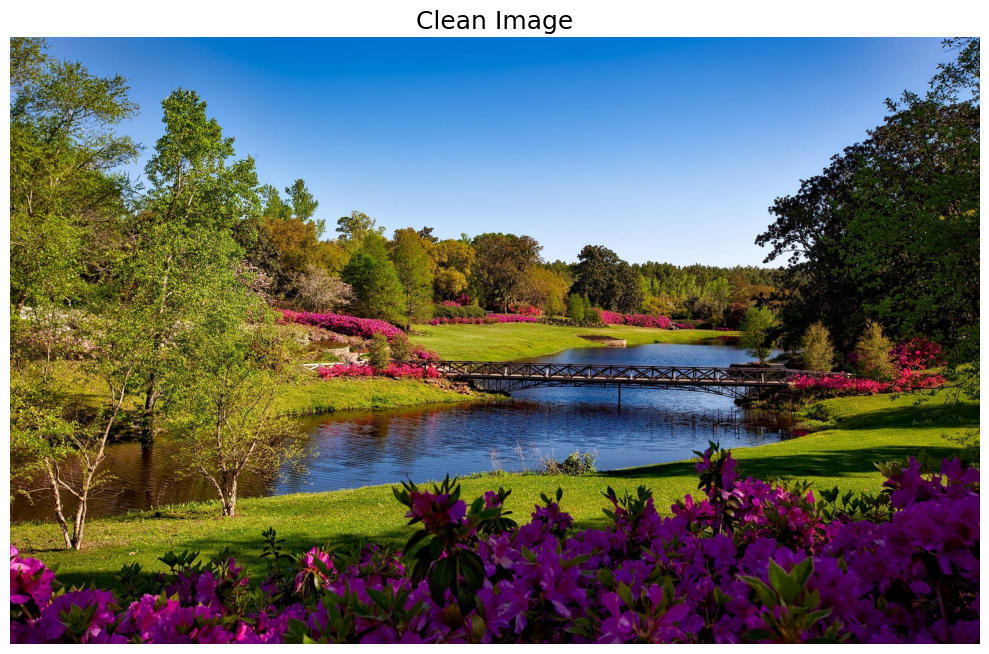

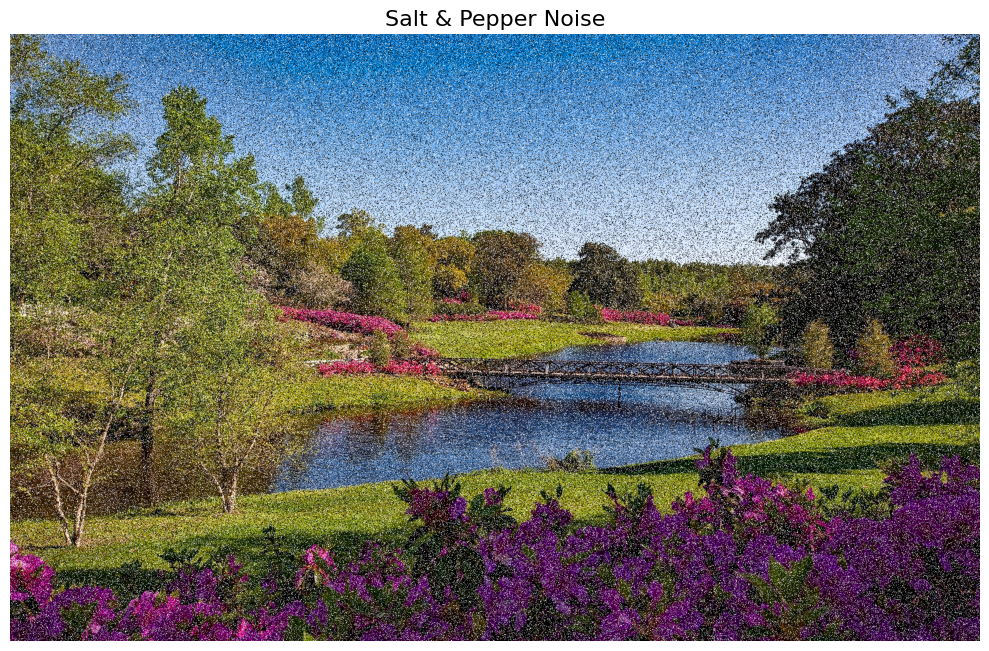

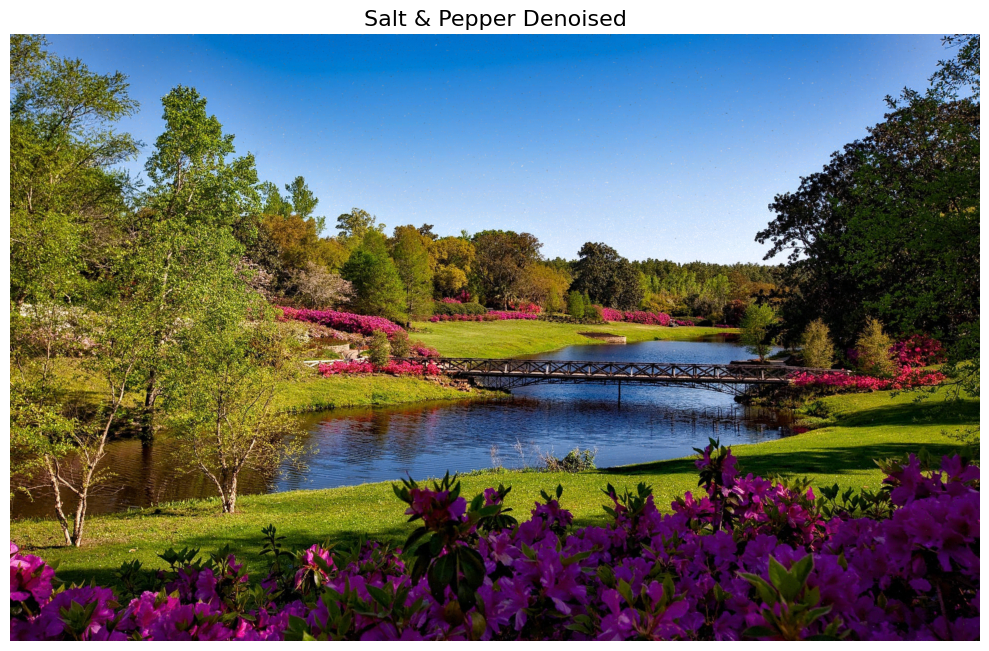

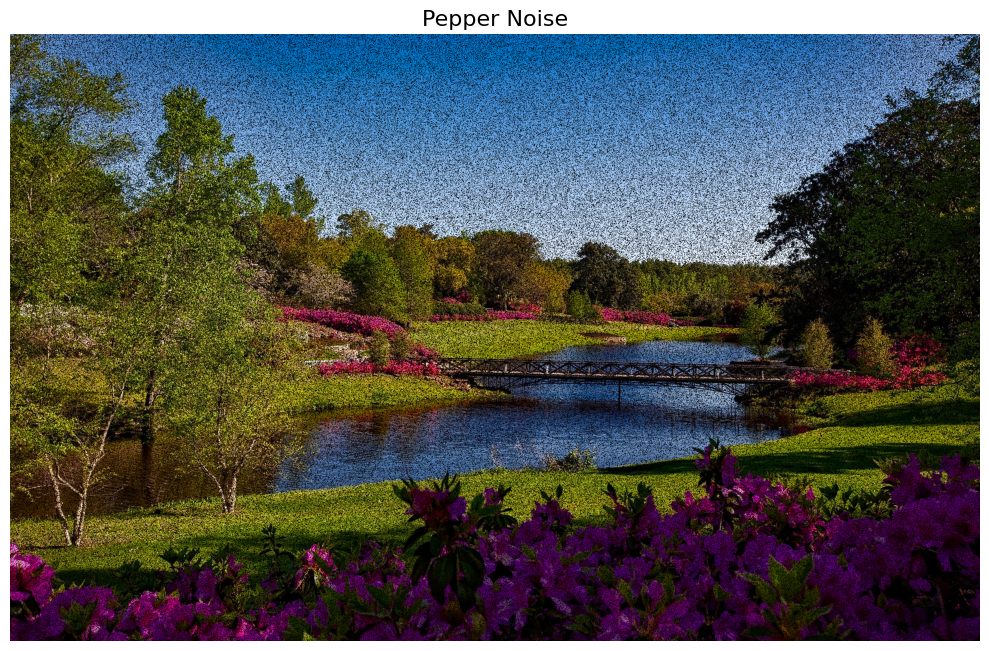

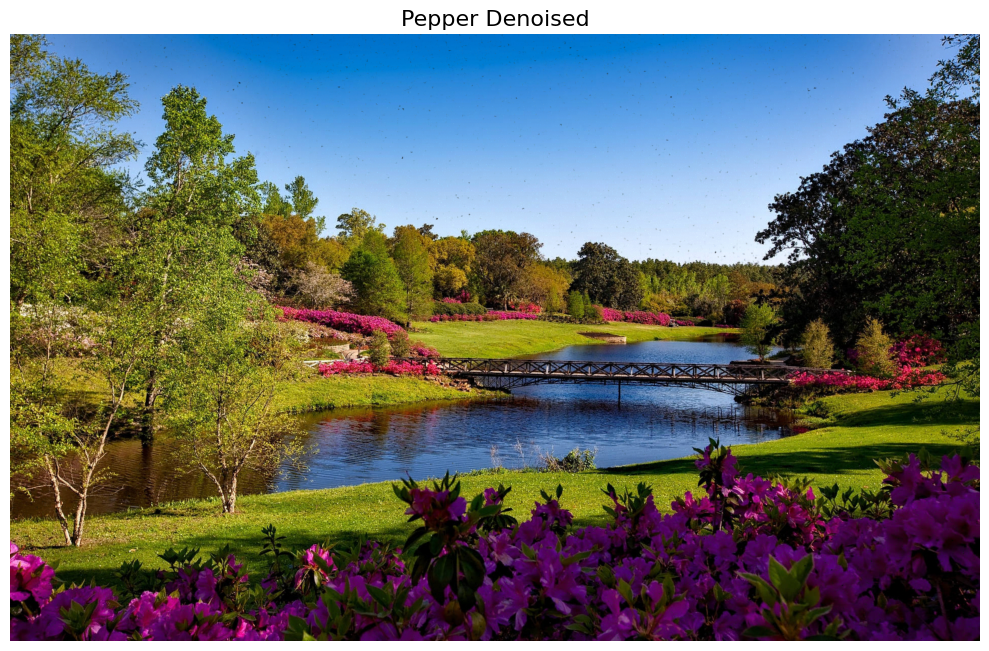

In [6]:
# --- Load model ---
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

model = ResNet().to(device)
model.load_state_dict(torch.load("/content/drive/MyDrive/denoise/checkpoints/res_discreet.pth", map_location=torch.device('cpu')))
model.eval()

# --- Load clean image ---
image_path = "/content/drive/MyDrive/denoise/test_images/flowers.png"
clean_img = io.imread(image_path) / 255.0
if clean_img.ndim == 2:
    clean_img = np.stack([clean_img] * 3, axis=-1)
elif clean_img.shape[2] > 3:
    clean_img = clean_img[:, :, :3]
clean_img = clean_img.astype(np.float32)

# --- Apply noise ---
noisy_versions = {
    "Salt & Pepper": apply_saltpepper_noise(clean_img, 0.1).clip(0, 1),
    "Pepper": apply_pepper_noise(clean_img, 0.1).clip(0, 1),
}


# --- Denoising function ---
def denoise_image(noisy_img, crop_size=128, stride=32):
    h, w, _ = noisy_img.shape
    output_img = np.zeros((h, w, 3), dtype=np.float32)
    weight_mask = np.zeros((h, w, 3), dtype=np.float32)

    # Generate all possible crop positions including edges
    row_positions = list(range(0, h - crop_size + 1, stride))
    col_positions = list(range(0, w - crop_size + 1, stride))

    # Add edge positions if they're not already included
    if row_positions[-1] != h - crop_size:
        row_positions.append(h - crop_size)
    if col_positions[-1] != w - crop_size:
        col_positions.append(w - crop_size)

    for i in tqdm(row_positions, desc="Processing rows"):
        for j in col_positions:
            # Extract crop
            crop = noisy_img[i:i+crop_size, j:j+crop_size, :]

            # Process with model
            input_tensor = torch.tensor(crop.transpose(2, 0, 1), dtype=torch.float32).unsqueeze(0).to(device)
            with torch.no_grad():
                output = model(input_tensor).squeeze(0).cpu().numpy().transpose(1, 2, 0)

            # Add to output with proper weighting
            output_img[i:i+crop_size, j:j+crop_size, :] += output
            weight_mask[i:i+crop_size, j:j+crop_size, :] += 1.0

    # Average overlapping regions
    return (output_img / np.maximum(weight_mask, 1e-8)).clip(0, 1)

# --- Run denoising ---
results = {}
for name, noisy in noisy_versions.items():
    print(f"\n--- Denoising {name} ---")
    results[name] = denoise_image(noisy, stride=32)

def show_results(clean, noisy_dict, denoised_dict):
    import matplotlib.pyplot as plt

    # Display clean image
    plt.figure(figsize=(10, 10))
    plt.imshow(clean)
    plt.title("Clean Image", fontsize=18)
    plt.axis('off')
    plt.tight_layout()
    plt.show()

    # Display each noisy and its denoised version, one per row
    for name in noisy_dict:
        # Noisy image
        plt.figure(figsize=(10, 10))
        plt.imshow(noisy_dict[name])
        plt.title(f"{name} Noise", fontsize=16)
        plt.axis('off')
        plt.tight_layout()
        plt.show()

        # Denoised image
        plt.figure(figsize=(10, 10))
        plt.imshow(denoised_dict[name])
        plt.title(f"{name} Denoised", fontsize=16)
        plt.axis('off')
        plt.tight_layout()
        plt.show()

show_results(clean_img, noisy_versions, results)



--- Denoising Gaussian ---


Processing rows: 100%|██████████| 19/19 [00:02<00:00,  6.91it/s]



--- Denoising Poisson ---


Processing rows: 100%|██████████| 19/19 [00:02<00:00,  7.33it/s]



--- Denoising Speckle ---


Processing rows: 100%|██████████| 19/19 [00:02<00:00,  7.33it/s]


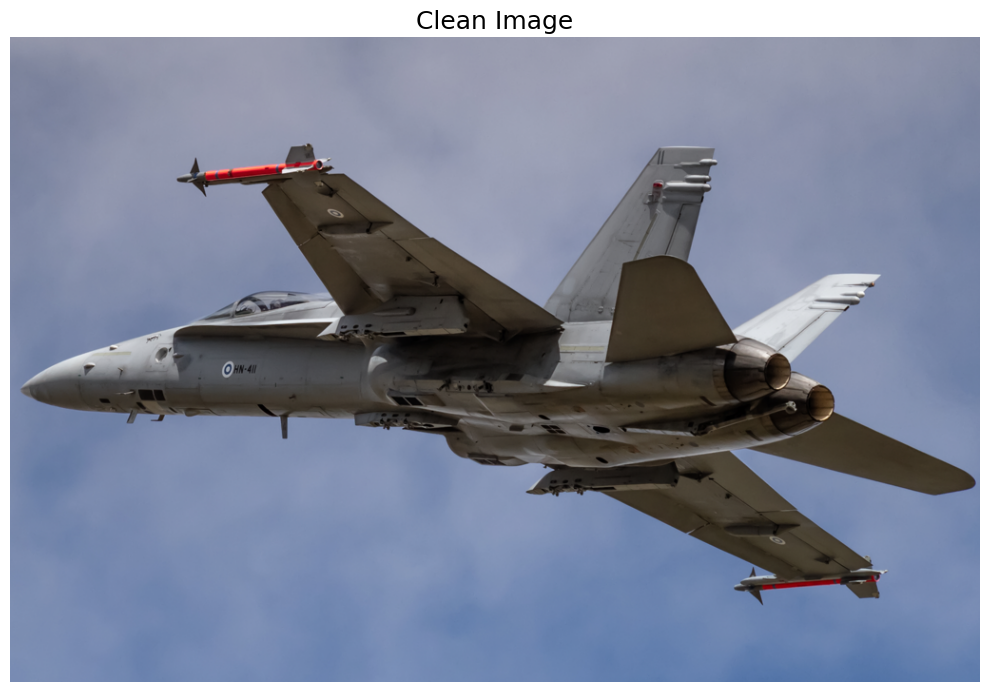

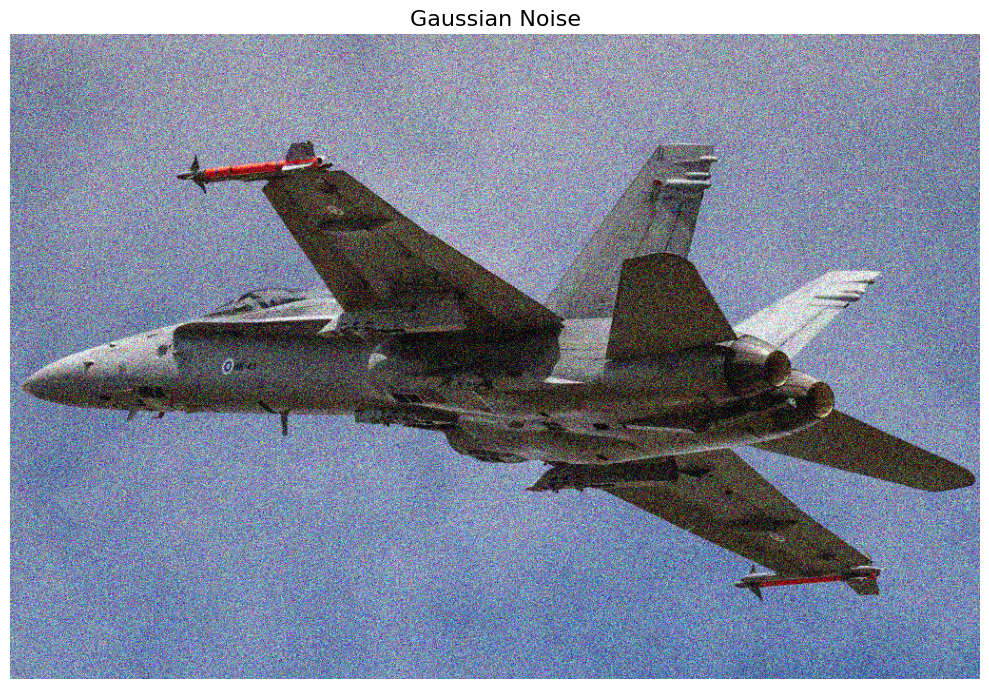

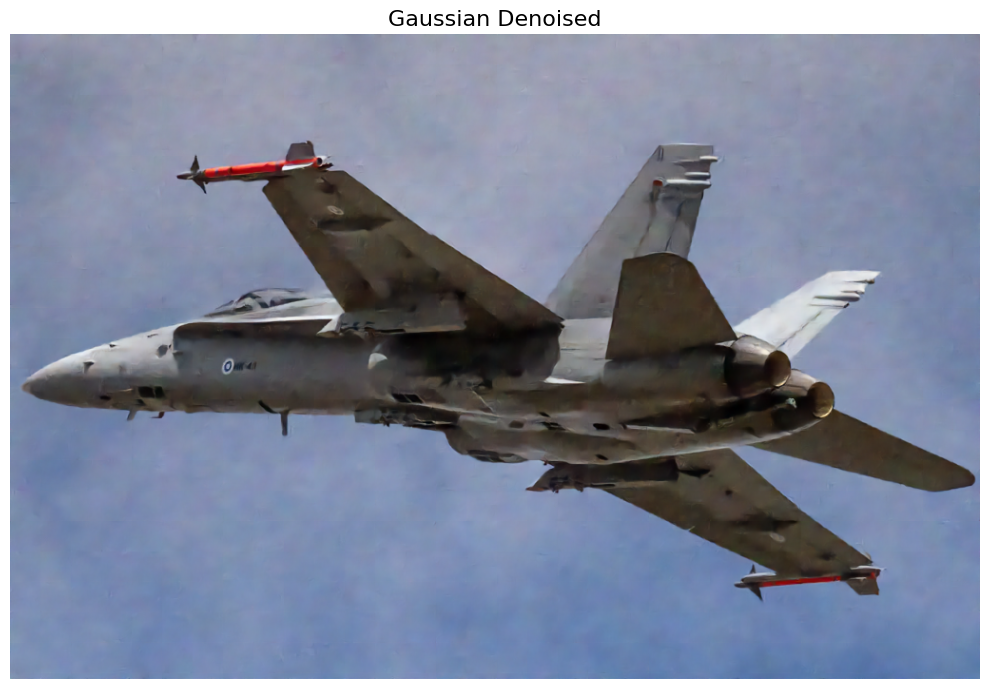

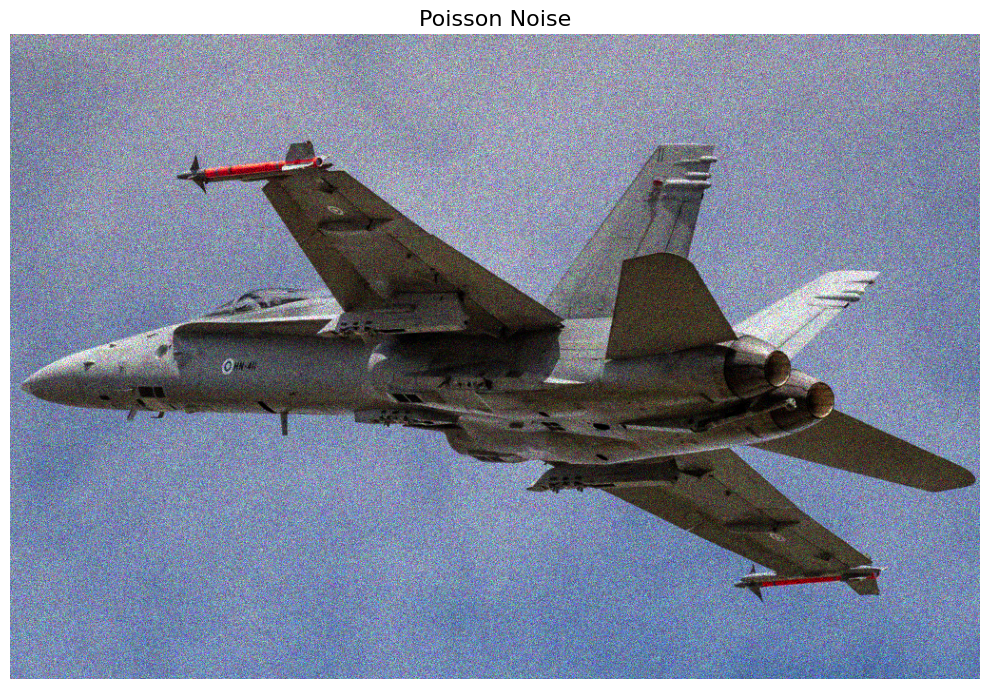

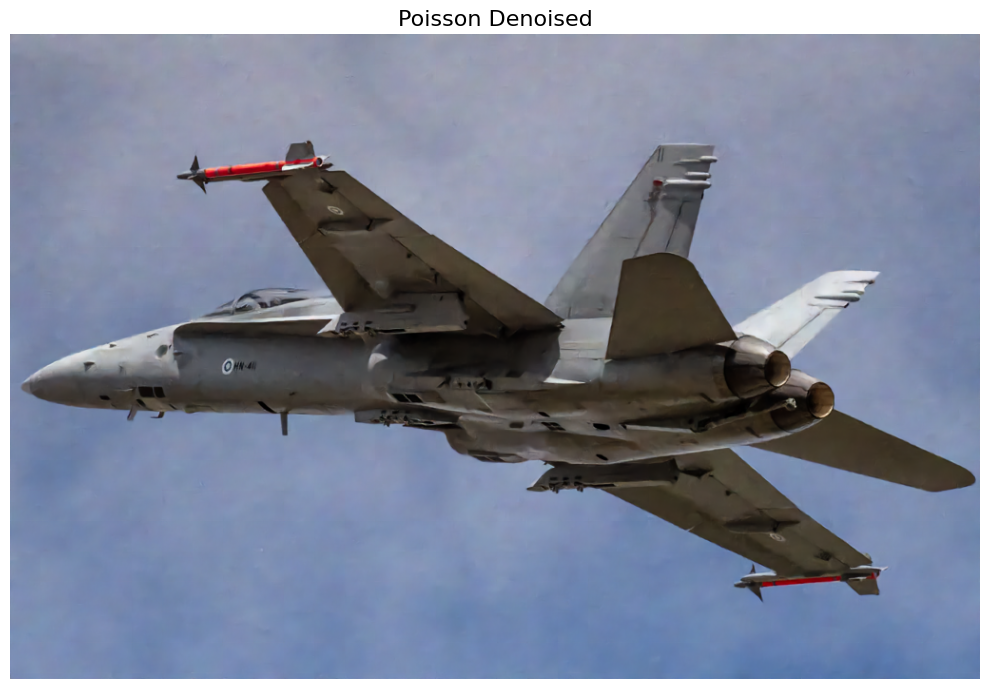

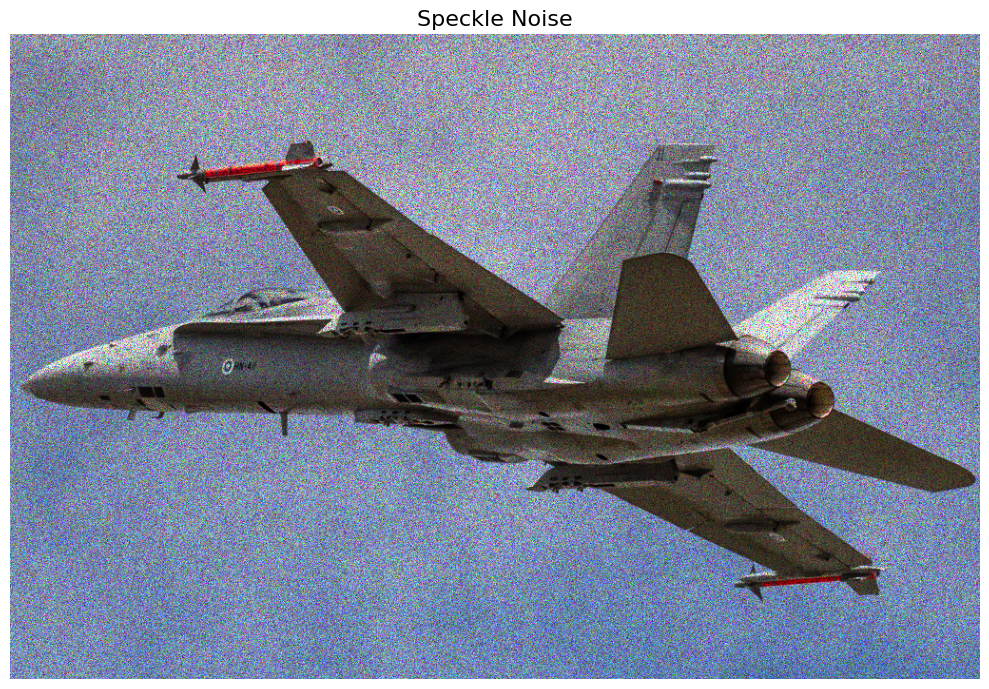

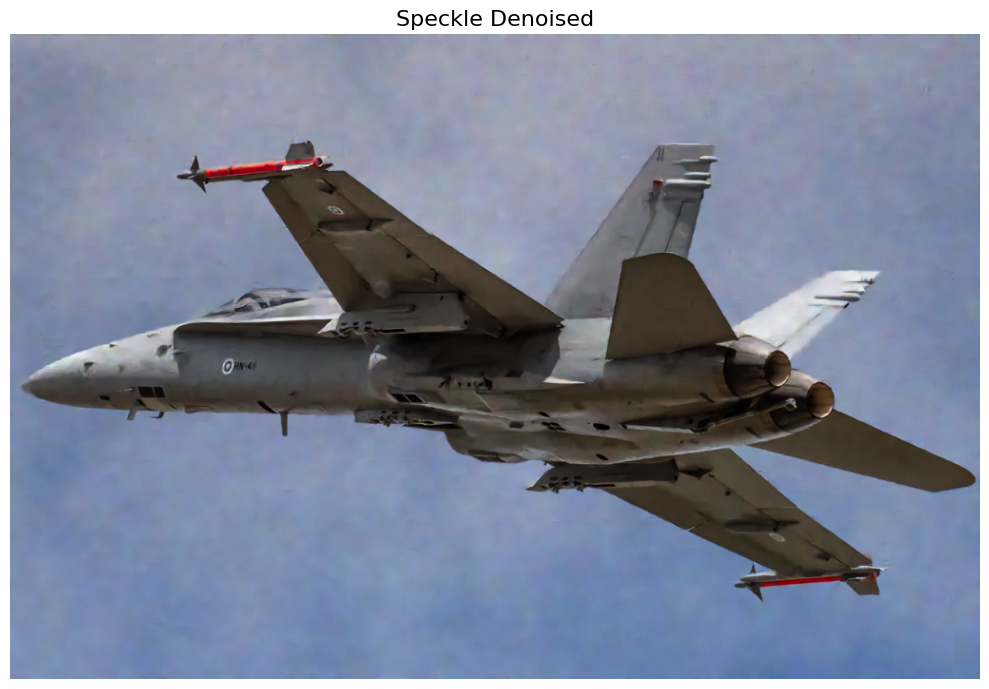

In [11]:
# --- Load model ---
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

model = ResNet().to(device)
model.load_state_dict(torch.load("/content/drive/MyDrive/denoise/checkpoints/res_smooth.pth", map_location=torch.device('cpu')))
model.eval()

# --- Load clean image ---
image_path = "/content/drive/MyDrive/denoise/test_images/jet.png"
clean_img = io.imread(image_path) / 255.0
if clean_img.ndim == 2:
    clean_img = np.stack([clean_img] * 3, axis=-1)
elif clean_img.shape[2] > 3:
    clean_img = clean_img[:, :, :3]
clean_img = clean_img.astype(np.float32)

# --- Apply noise ---
noisy_versions = {
    "Gaussian": apply_gaussian_noise(clean_img, 0.15).clip(0, 1),
    "Poisson": apply_poisson_noise(clean_img).clip(0, 1),
    "Speckle": apply_speckle_noise(clean_img, 0.3).clip(0, 1)
}

# --- Denoising function ---
def denoise_image(noisy_img, crop_size=128, stride=32):
    h, w, _ = noisy_img.shape
    output_img = np.zeros((h, w, 3), dtype=np.float32)
    weight_mask = np.zeros((h, w, 3), dtype=np.float32)

    # Generate all possible crop positions including edges
    row_positions = list(range(0, h - crop_size + 1, stride))
    col_positions = list(range(0, w - crop_size + 1, stride))

    # Add edge positions if they're not already included
    if row_positions[-1] != h - crop_size:
        row_positions.append(h - crop_size)
    if col_positions[-1] != w - crop_size:
        col_positions.append(w - crop_size)

    for i in tqdm(row_positions, desc="Processing rows"):
        for j in col_positions:
            # Extract crop
            crop = noisy_img[i:i+crop_size, j:j+crop_size, :]

            # Process with model
            input_tensor = torch.tensor(crop.transpose(2, 0, 1), dtype=torch.float32).unsqueeze(0).to(device)
            with torch.no_grad():
                output = model(input_tensor).squeeze(0).cpu().numpy().transpose(1, 2, 0)

            # Add to output with proper weighting
            output_img[i:i+crop_size, j:j+crop_size, :] += output
            weight_mask[i:i+crop_size, j:j+crop_size, :] += 1.0

    # Average overlapping regions
    return (output_img / np.maximum(weight_mask, 1e-8)).clip(0, 1)

# --- Run denoising ---
results = {}
for name, noisy in noisy_versions.items():
    print(f"\n--- Denoising {name} ---")
    results[name] = denoise_image(noisy, stride=32)

def show_results(clean, noisy_dict, denoised_dict):
    import matplotlib.pyplot as plt

    # Display clean image
    plt.figure(figsize=(10, 10))
    plt.imshow(clean)
    plt.title("Clean Image", fontsize=18)
    plt.axis('off')
    plt.tight_layout()
    plt.show()

    # Display each noisy and its denoised version, one per row
    for name in noisy_dict:
        # Noisy image
        plt.figure(figsize=(10, 10))
        plt.imshow(noisy_dict[name])
        plt.title(f"{name} Noise", fontsize=16)
        plt.axis('off')
        plt.tight_layout()
        plt.show()

        # Denoised image
        plt.figure(figsize=(10, 10))
        plt.imshow(denoised_dict[name])
        plt.title(f"{name} Denoised", fontsize=16)
        plt.axis('off')
        plt.tight_layout()
        plt.show()

show_results(clean_img, noisy_versions, results)


In [14]:
import os
from skimage import io, img_as_ubyte

# --- Load model ---
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = ResNet().to(device)
model.load_state_dict(torch.load("/content/drive/MyDrive/denoise/checkpoints/res_discreet.pth", map_location='cpu'))
model.eval()

# --- Load clean image ---
image_path = "/content/drive/MyDrive/denoise/test_images/tree.png"
image_name = os.path.splitext(os.path.basename(image_path))[0]
clean_img = io.imread(image_path) / 255.0
if clean_img.ndim == 2:
    clean_img = np.stack([clean_img] * 3, axis=-1)
elif clean_img.shape[2] > 3:
    clean_img = clean_img[:, :, :3]
clean_img = clean_img.astype(np.float32)

# --- Apply noise ---
noisy_versions = {
    "saltpepper": apply_saltpepper_noise(clean_img, 0.1).clip(0, 1),
    "pepper": apply_pepper_noise(clean_img, 0.1).clip(0, 1),
}

# --- Results directory ---
results_dir = "/content/drive/MyDrive/denoise/results/"
os.makedirs(results_dir, exist_ok=True)

# --- Save clean image ---
clean_save_path = os.path.join(results_dir, f"{image_name}_clean.png")
io.imsave(clean_save_path, img_as_ubyte(clean_img))

# --- Denoising function with batching stays the same ---
def denoise_image(noisy_img, crop_size=128, stride=32):
    h, w, _ = noisy_img.shape
    output_img = np.zeros((h, w, 3), dtype=np.float32)
    weight_mask = np.zeros((h, w, 3), dtype=np.float32)

    row_positions = list(range(0, h - crop_size + 1, stride))
    col_positions = list(range(0, w - crop_size + 1, stride))
    if row_positions[-1] != h - crop_size:
        row_positions.append(h - crop_size)
    if col_positions[-1] != w - crop_size:
        col_positions.append(w - crop_size)

    for i in tqdm(row_positions, desc="Processing rows"):
        for j in col_positions:
            crop = noisy_img[i:i+crop_size, j:j+crop_size, :]
            input_tensor = torch.tensor(crop.transpose(2, 0, 1), dtype=torch.float32).unsqueeze(0).to(device)
            with torch.no_grad():
                output = model(input_tensor).squeeze(0).cpu().numpy().transpose(1, 2, 0)

            output_img[i:i+crop_size, j:j+crop_size, :] += output
            weight_mask[i:i+crop_size, j:j+crop_size, :] += 1.0

    return (output_img / np.maximum(weight_mask, 1e-8)).clip(0, 1)

# --- Denoise, save images ---
for noise_type, noisy in noisy_versions.items():
    print(f"\n--- Denoising {noise_type} ---")

    # Save noisy image
    noisy_save_path = os.path.join(results_dir, f"{image_name}_{noise_type}.png")
    io.imsave(noisy_save_path, img_as_ubyte(noisy))

    # Denoise and save result
    result = denoise_image(noisy, stride=32)
    result_save_path = os.path.join(results_dir, f"{image_name}_{noise_type}_result.png")
    io.imsave(result_save_path, img_as_ubyte(result))

    print(f"✅ Saved: {noisy_save_path}, {result_save_path}")

print("✅ All outputs saved to:", results_dir)



--- Denoising saltpepper ---


Processing rows: 100%|██████████| 19/19 [00:02<00:00,  7.01it/s]


✅ Saved: /content/drive/MyDrive/denoise/results/tree_saltpepper.png, /content/drive/MyDrive/denoise/results/tree_saltpepper_result.png

--- Denoising pepper ---


Processing rows: 100%|██████████| 19/19 [00:02<00:00,  7.15it/s]


✅ Saved: /content/drive/MyDrive/denoise/results/tree_pepper.png, /content/drive/MyDrive/denoise/results/tree_pepper_result.png
✅ All outputs saved to: /content/drive/MyDrive/denoise/results/


In [13]:
import os
from skimage import io, img_as_ubyte

# --- Load model ---
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = ResNet().to(device)
model.load_state_dict(torch.load("/content/drive/MyDrive/denoise/checkpoints/res_smooth.pth", map_location='cpu'))
model.eval()

# --- Load clean image ---
image_path = "/content/drive/MyDrive/denoise/test_images/jet.png"
image_name = os.path.splitext(os.path.basename(image_path))[0]
clean_img = io.imread(image_path) / 255.0
if clean_img.ndim == 2:
    clean_img = np.stack([clean_img] * 3, axis=-1)
elif clean_img.shape[2] > 3:
    clean_img = clean_img[:, :, :3]
clean_img = clean_img.astype(np.float32)

# --- Apply noise ---
noisy_versions = {
    "Gaussian": apply_gaussian_noise(clean_img, 0.15).clip(0, 1),
    "Poisson": apply_poisson_noise(clean_img).clip(0, 1),
    "Speckle": apply_speckle_noise(clean_img, 0.3).clip(0, 1)
}

# --- Results directory ---
results_dir = "/content/drive/MyDrive/denoise/results/"
os.makedirs(results_dir, exist_ok=True)

# --- Save clean image ---
clean_save_path = os.path.join(results_dir, f"{image_name}_clean.png")
io.imsave(clean_save_path, img_as_ubyte(clean_img))

# --- Denoising function with batching stays the same ---
def denoise_image(noisy_img, crop_size=128, stride=32):
    h, w, _ = noisy_img.shape
    output_img = np.zeros((h, w, 3), dtype=np.float32)
    weight_mask = np.zeros((h, w, 3), dtype=np.float32)

    row_positions = list(range(0, h - crop_size + 1, stride))
    col_positions = list(range(0, w - crop_size + 1, stride))
    if row_positions[-1] != h - crop_size:
        row_positions.append(h - crop_size)
    if col_positions[-1] != w - crop_size:
        col_positions.append(w - crop_size)

    for i in tqdm(row_positions, desc="Processing rows"):
        for j in col_positions:
            crop = noisy_img[i:i+crop_size, j:j+crop_size, :]
            input_tensor = torch.tensor(crop.transpose(2, 0, 1), dtype=torch.float32).unsqueeze(0).to(device)
            with torch.no_grad():
                output = model(input_tensor).squeeze(0).cpu().numpy().transpose(1, 2, 0)

            output_img[i:i+crop_size, j:j+crop_size, :] += output
            weight_mask[i:i+crop_size, j:j+crop_size, :] += 1.0

    return (output_img / np.maximum(weight_mask, 1e-8)).clip(0, 1)

# --- Denoise, save images ---
for noise_type, noisy in noisy_versions.items():
    print(f"\n--- Denoising {noise_type} ---")

    # Save noisy image
    noisy_save_path = os.path.join(results_dir, f"{image_name}_{noise_type}.png")
    io.imsave(noisy_save_path, img_as_ubyte(noisy))

    # Denoise and save result
    result = denoise_image(noisy, stride=32)
    result_save_path = os.path.join(results_dir, f"{image_name}_{noise_type}_result.png")
    io.imsave(result_save_path, img_as_ubyte(result))

    print(f"✅ Saved: {noisy_save_path}, {result_save_path}")

print("✅ All outputs saved to:", results_dir)



--- Denoising Gaussian ---


Processing rows: 100%|██████████| 19/19 [00:02<00:00,  6.94it/s]


✅ Saved: /content/drive/MyDrive/denoise/results/jet_Gaussian.png, /content/drive/MyDrive/denoise/results/jet_Gaussian_result.png

--- Denoising Poisson ---


Processing rows: 100%|██████████| 19/19 [00:03<00:00,  6.31it/s]


✅ Saved: /content/drive/MyDrive/denoise/results/jet_Poisson.png, /content/drive/MyDrive/denoise/results/jet_Poisson_result.png

--- Denoising Speckle ---


Processing rows: 100%|██████████| 19/19 [00:02<00:00,  6.92it/s]


✅ Saved: /content/drive/MyDrive/denoise/results/jet_Speckle.png, /content/drive/MyDrive/denoise/results/jet_Speckle_result.png
✅ All outputs saved to: /content/drive/MyDrive/denoise/results/
